# Predict Using YOLOv8

Purpose - A notebook with code for detecting objects on new images using image tiling and YOLOv8.  
Author - Ryan Folks

---

## Load Model

In [ ]:
import sys
import os
sys.path.append(os.path.join("..", "..", "..", "ChartExtractor", "src"))

In [29]:
from object_detection_models.ultralytics_yolov8 import UltralyticsYOLOv8
from utilities.tiling import tile_image
from utilities.detections import Detection
from utilities.detection_reassembly import untile_detections, non_maximum_suppression, intersection_over_minimum
from pathlib import Path
from typing import List
from dotenv import load_dotenv, dotenv_values
from PIL import Image, ImageDraw

In [6]:
load_dotenv()

True

In [8]:
model = UltralyticsYOLOv8.from_weights_path(os.getenv("NUMBER_MODEL_PATH")) # choose the model you want.

## Predict

In [31]:
image_filepath: Path = Path("E:")/"data"/"real_charts"/"RC_0030_intraoperative.JPG" # choose the image you want.
image: Image.Image = Image.open(image_filepath)
tile_width, tile_height = 256, 256
horizontal_overlap_ratio, vertical_overlap_ratio = 0.5, 0.5
image_tiles: List[List[Image.Image]] = tile_image(image, tile_width, tile_height, horizontal_overlap_ratio, vertical_overlap_ratio)

In [32]:
detections: List[List[Detection]] = [
    [model(tile) for tile in row]
    for row in image_tiles
]

In [33]:
detections: List[Detection] = untile_detections(detections, tile_width, tile_height, horizontal_overlap_ratio, vertical_overlap_ratio)
detections: List[Detection] = non_maximum_suppression(detections, overlap_comparator=intersection_over_minimum)

## Visualize

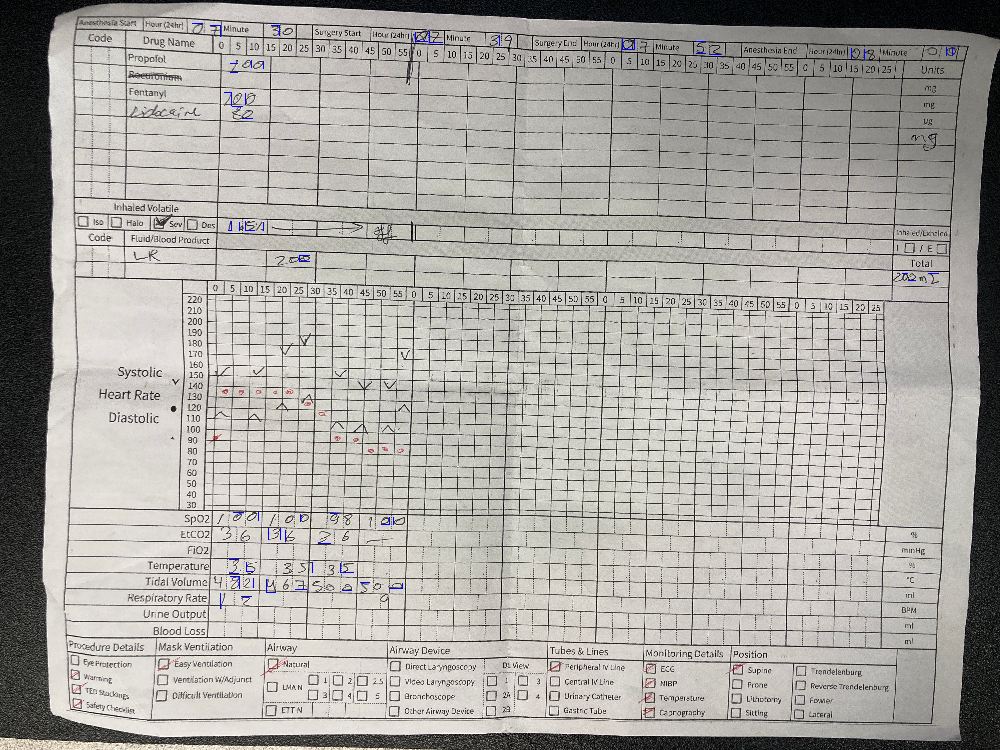

In [34]:
image_copy = image.copy()
draw = ImageDraw.Draw(image_copy)
for detection in detections:
    draw.rectangle(detection.annotation.box, outline="blue")
image_copy